## Preprocessing and Segmentation
(`denoising_and_segmentation.py`)
- Denoising H&E images.
- Perform nuclei segmentation using Stardist.

### Download high-resolution H&E images and spatial transcriptome data

In [ ]:
!curl -O https://cf.10xgenomics.com/samples/spatial-exp/2.1.0/CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain/CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain_tissue_image.tif

In [ ]:
!curl -O https://cf.10xgenomics.com/samples/spatial-exp/2.1.0/CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain/CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain__spatial.tar.gz

### Unzip the downloaded file

In [ ]:
import tarfile

# Define the file path
tar_path = "CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain_spatial.tar.gz"
extract_path = "./spatial"  

# Open and unzip
with tarfile.open(tar_path, "r:gz") as tar:
    tar.extractall(path=extract_path)

print(f"Decompression completed, the files have been extracted to: {extract_path}")

##  Library Import and Juypter Notebook Setup

In [1]:
from csbdeep.utils import normalize
from stardist.models import StarDist2D
import numpy as np
import matplotlib.pyplot as plt
import squidpy as sq
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import anndata
import geopandas as gpd
import scanpy as sc
from tifffile import imread, imwrite
from shapely.geometry import Polygon, Point
from scipy import sparse
from matplotlib.colors import ListedColormap
import cv2
from skimage.io import imread
from skimage.measure import find_contours
import seaborn as sns
import json
from PIL import Image
import os
import multiprocessing as mp
from tqdm import tqdm


%matplotlib inline
%config InlineBackend.figure_format = 'retina'

2025-02-17 00:27:02.022078: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1739748422.041095 3956012 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1739748422.046988 3956012 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-17 00:27:02.068583: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
backends.py (135): networkx backend defined more than once: nx-loopback
decorators.py (246): nopython is set for njit and is 

## preprocessing, setting noise mask.
> *Note: Here, we provide **3** methods to set the noise mask: **default**, **KMeans-based** and **manually set**.*

- **Default**:
here default noise mask is:  
lower_color = np.array([154, 137, 107])  # Lower noise limits of H, S, V
upper_color = np.array([162, 207, 211])  # Upper noise limits of H, S, V

Default replacement color is:  
replacement_color = np.array([160, 115, 250], dtype=np.uint8)    

To accommodate diverse datasets, SegDecon provides a KMeans-based method for dynamically determining the optimal hue threshold.(`kmeans_noise_filter.py` or the notebook :). This approach clusters pixel colors into different groups and selects the cluster corresponding to noise artifacts. However, for precise noise removal, a hybrid approach is recommended, where the manually selected thresholds are refined by taking the union of hue values from at least **ten** representative noise pixels. This combined strategy ensures more accurate and dataset-specific noise suppression while maintaining robust segmentation performance.

- **KMeans-based method**: `kmeans_noise_filter.py`
  
- **Below are the steps for manual setup.**
As mentioned earlier, the user should take the union of hue values from at least **ten** representative noise pixels.

Next, the user should select 10-15 regions of interest (clear noise areas) from the high-resolution H&E image. We recommend using [ImageJ](https://imagej.nih.gov/ij/) for this task. 

From these 10-15 clear noise regions, use the `Analyse -> Measure` option or the shortcut `Ctrl + M` to view the color values (RGB values) of the pixels. 

Once you have these values, input them into the corresponding sections of the code below. This will allow you to obtain the threshold values for the noise in HSV format for your sample.

In [2]:
# An example for manually setting.

# List of RGBA colors of selected noise pixels
rgba_colors = [
    (180, 67, 162, 255),
    (172, 61, 172, 255),
    (134, 48, 106, 255),
    (149, 50, 120, 255),
    (140, 44, 112, 255),
    (171, 69, 139, 255),
    (162, 63, 147, 255),
    (151, 53, 143, 255),
    (151, 53, 143, 255),
    (169, 62, 148, 255),
    (156, 68, 140, 255),
    (153, 62, 143, 255),
]

# Store all HSV values
hsv_values = []

# Convert each RGBA color to HSV
for rgba in rgba_colors:
    r, g, b, a = rgba
    # Convert RGB to the range [0, 255]
    rgb = np.array([r, g, b], dtype=np.uint8).reshape(1, 1, 3)
    
    # Convert RGB to HSV using OpenCV
    hsv = cv2.cvtColor(rgb, cv2.COLOR_RGB2HSV)[0][0]
    
    hsv_values.append(hsv)

# Convert to NumPy array for easy calculation
hsv_values = np.array(hsv_values)

# Calculate the minimum and maximum values of each channel as the noise threshold range
lower_color = np.min(hsv_values, axis=0)
upper_color = np.max(hsv_values, axis=0)

print("HSV minimum (lower_color):", lower_color)
print("HSV maximum (upper_color):", upper_color)


HSV minimum (lower_color): [150 144 134]
HSV maximum (upper_color): [160 175 180]


### Denoising and visualisation.
- Here we can use the noise range we get in last cell or from `kmeans_noise_filter.py` or default values mentioned above.
- The kernel size is set manually, the default value is (15,15). 15 - 25 is recommended.  
For datasets with **excessively small noise points**, to prevent the denoised noise regions from remaining as granular small spots, which could affect subsequent segmentation, it is recommended to use a **larger** kernel value, such as 20.  
  
First, we select a noisy area and apply the resulting noise threshold range to visualize the noise reduction effect.

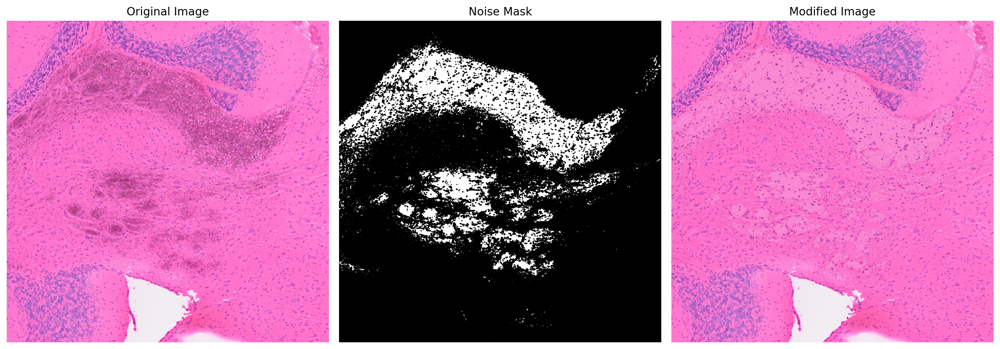

In [3]:
# Read image and convert to HSV
img_he = imread('../CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain_tissue_image.tif', plugin='tifffile')
img_hsv = cv2.cvtColor(img_he, cv2.COLOR_RGB2HSV)

# Crop the image
crop_he = img_he[17500:22500, 7000:12000]
crop_hsv = img_hsv[17500:22500, 7000:12000]

# Set the noise range
# Here we can use the noise range we get in last cell or from `kmeans_noise_filter.py` or default values.
# Here a specific value is used for this dataset.
lower_noise = np.array([159.5, 137.7,140.25]) 
upper_noise = np.array([162.5, 206.55,211.65])  

# Creating a Noise Mask
noise_mask = cv2.inRange(crop_hsv, lower_noise, upper_noise)

# Morphological operations connect hotspot regions
# The kernel size is set manually, the default value is (15,15), 15 - 25 is recommended.
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
connected_noise = cv2.morphologyEx(noise_mask, cv2.MORPH_CLOSE, kernel)

# Replace the noise area with the background color
replacement_color = np.array([321 / 2, 45 * 2.55, 98 * 2.55])  # background HSV
crop_hsv[connected_noise > 0] = replacement_color

# Convert back to RGB
modified_crop = cv2.cvtColor(crop_hsv, cv2.COLOR_HSV2RGB)

# Visualize the results
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.imshow(crop_he)
plt.title("Original Image")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(connected_noise, cmap='gray')
plt.title("Noise Mask")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(modified_crop)
plt.title("Modified Image")
plt.axis('off')

plt.tight_layout()
plt.show()


To further check the effect of denoising , user can select a smaller noise area to check.   Verify the accuracy of the threshold and make adjustments.

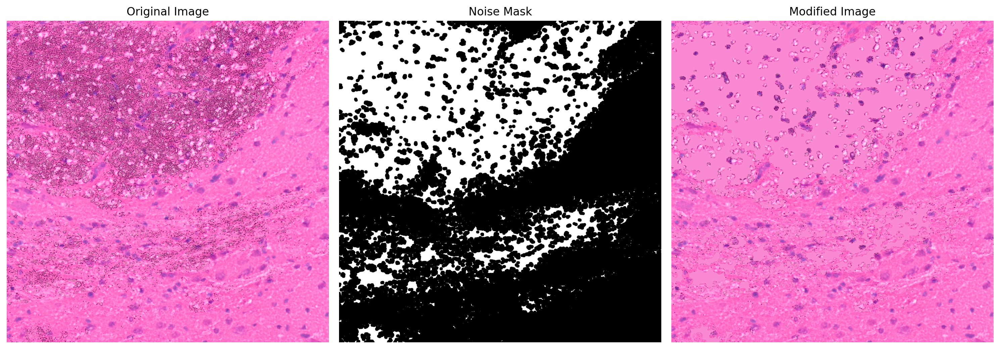

In [ ]:
# Read image and convert to HSV
img_he = imread('../CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain_tissue_image.tif', plugin='tifffile')
img_hsv = cv2.cvtColor(img_he, cv2.COLOR_RGB2HSV)

# Crop the image
crop_he = img_he[19000:20500, 10000:11500]
crop_hsv = img_hsv[19000:20500, 10000:11500]

# Set the noise range
lower_noise = np.array([159.5, 137.7,140.25])  
upper_noise = np.array([162.5, 206.55,211.65])  

# Creating a Noise Mask
noise_mask = cv2.inRange(crop_hsv, lower_noise, upper_noise)

# Morphological operations connect hotspot regions
# The kernel size is set manually, the default value is (15,15), 15 - 25 is recommended.
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
connected_noise = cv2.morphologyEx(noise_mask, cv2.MORPH_CLOSE, kernel)

# Replace the noise area with the background color
replacement_color = np.array([321 / 2, 45 * 2.55, 98 * 2.55])  # background HSV
crop_hsv[connected_noise > 0] = replacement_color

# Convert back to RGB
modified_crop = cv2.cvtColor(crop_hsv, cv2.COLOR_HSV2RGB)

# Visualize the results
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.imshow(crop_he)
plt.title("Original Image")
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(connected_noise, cmap='gray')
plt.title("Noise Mask")
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(modified_crop)
plt.title("Modified Image")
plt.axis('off')

plt.tight_layout()
plt.show()


From the abouve results, we can see the effect of denoising is very well, so the denoising threshold determined. After have a certain values of noise mask for the data, we can apply this threshold value on whole image.

In [ ]:
%%time

# Set the noise threshold 
lower_noise = np.array([319 / 2, 54 * 2.55, 55 * 2.55])  # lower threshold
upper_noise = np.array([325 / 2, 81 * 2.55, 83 * 2.55])  # upper threshold

# Create the noise mask
mask = cv2.inRange(img_hsv, lower_noise, upper_noise)

# Morphological operations connect regions
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15)) # Resize, control consistency
connected_mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)

# Replaces consecutive regions with the specified HSV values
replacement_color = np.array([321 / 2, 45 * 2.55, 98 * 2.55], dtype=np.uint8)  # Convert to integer HSV value
replacement_color = replacement_color.reshape(1, 1, 3)  

# Apply replacement to HSV image
img_hsv[connected_mask > 0] = replacement_color

# Convert the H&E image back to RGB format
modified_img = cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB)

CPU times: user 23.5 s, sys: 2.35 s, total: 25.9 s
Wall time: 18.7 s


### Percentile Normalization
After modifying the image, it is percentile normalized. Adjust the min and max percentile parameters as needed for other images by assessing the image mask for accuracy. Percentile normalization scales pixel values by the specified min and max percentiles.

In [6]:
%%time

img = modified_img
model = StarDist2D.from_pretrained('2D_versatile_he')
# Percentile normalization of the image
# Adjust min_percentile and max_percentile as needed
min_percentile = 5
max_percentile = 95
img = normalize(img, min_percentile, max_percentile)

Found model '2D_versatile_he' for 'StarDist2D'.


I0000 00:00:1739748544.401788 3956012 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 31141 MB memory:  -> device: 0, name: Tesla V100-SXM2-32GB, pci bus id: 0000:85:00.0, compute capability: 7.0


Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.692478, nms_thresh=0.3.
CPU times: user 54.2 s, sys: 18 s, total: 1min 12s
Wall time: 1min 12s


### Segmentation
Execute the code block below to create the nucleus segmentation mask. This step has a runtime around 8 mins and it will vary significantly depending on the chosen parameter settings. The nms threshold *(nms_thresh)* is set to a small number to reduce the probability of nuclei overlap. The nms_thresh parameter may require adjustment for different images. Also, it may be necessary to adjust the probability threshold *(prob_thresh)* for different images.  
  
Larger *prob_thresh* values will result in fewer segmented objects. The optimal values for *prob_thresh* and nm_thresh will depend on visual assessment of the nucleus segmentation mask.  
Default settings are:
*prob_thresh=0.2,nms_thresh =0.001*

In [7]:
%%time
# Predict cell nuclei using the normalized image
# Adjust nms_thresh and prob_thresh 
labels, polys = model.predict_instances_big(img, axes='YXC', block_size=4096, prob_thresh=0.2,nms_thresh =0.001, min_overlap=128, context=128, normalizer=None, n_tiles=(4,4,1))

effective: block_size=(4096, 4096, 3), min_overlap=(128, 128, 0), context=(128, 128, 0)


I0000 00:00:1739748616.937793 3956527 service.cc:148] XLA service 0x14986400b050 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1739748616.937819 3956527 service.cc:156]   StreamExecutor device (0): Tesla V100-SXM2-32GB, Compute Capability 7.0
2025-02-17 00:30:16.962195: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1739748617.056017 3956527 cuda_dnn.cc:529] Loaded cuDNN version 90300
2025-02-17 00:30:17.313969: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{k25=0} for conv (f32[1,32,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[1,3,256,256]{3,2,1,0}, f32[32,3,3,3]{3,2,1,0}, f32[32]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config

CPU times: user 14min 24s, sys: 1min 20s, total: 15min 44s
Wall time: 8min 35s


### Visualize the results for one region of interest from the nucleus segmentation.

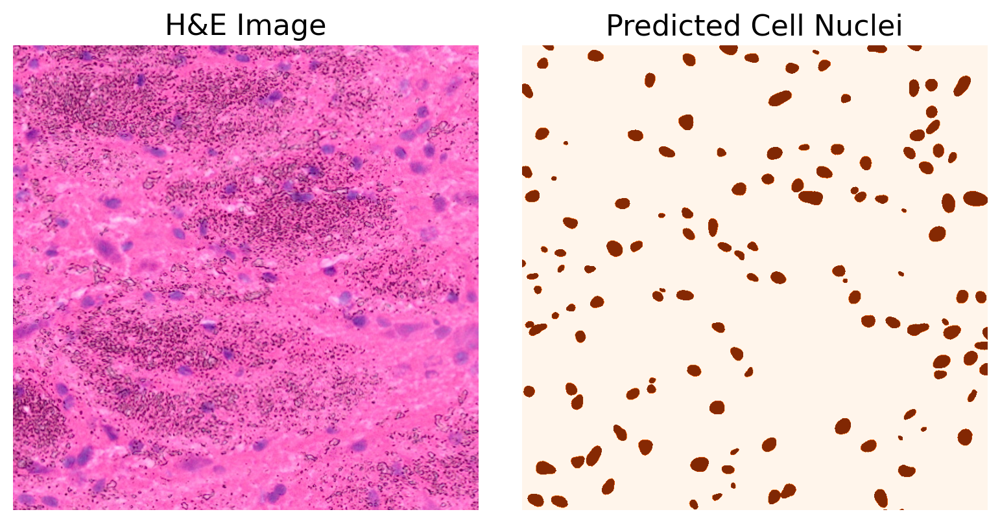

In [8]:
# crop_he = modified_img[17500:22500, 7000:12000]
# crop_pred = labels[17500:22500, 7000:12000]  

crop_he = img_he[20100:20900, 8700:9500]
crop_pred = labels[20100:20900, 8700:9500]

# Extract contours
contours = find_contours(crop_pred, level=0.5)  # Find the contour, level=0.5 is suitable for binary images

# Plot
fig, axes = plt.subplots(1, 2, figsize=(8, 4)) 
axes[0].imshow(crop_he)
axes[0].set_title('H&E Image',fontsize=16)
axes[0].axis('off')
axes[1].imshow(crop_pred, cmap= 'Oranges')
axes[1].set_title('Predicted Cell Nuclei',fontsize=16)
axes[1].axis('off')

# # Draw contours on H&E images
# for contour in contours:
#     axes[0].plot(contour[:, 1], contour[:, 0], color='blue', linewidth=0.8)  

plt.tight_layout()
plt.show()

### Filter the results.
A GeoDataframe is created. 
In this demonstration, we filter the results to remove very large nuclei, which could be improperly segmented nuclei aggregates or image artifacts. This step is optional and performing it will likely depend on the sample.

In [9]:
# Creating a list to store Polygon geometries
geometries = []

# Iterating through each nuclei in the 'polys' DataFrame
for nuclei in range(len(polys['coord'])):

    # Extracting coordinates for the current nuclei and converting them to (y, x) format
    coords = [(y, x) for x, y in zip(polys['coord'][nuclei][0], polys['coord'][nuclei][1])]

    # Creating a Polygon geometry from the coordinates
    geometries.append(Polygon(coords))

# Creating a GeoDataFrame using the Polygon geometries
gdf = gpd.GeoDataFrame(geometry=geometries)
gdf['id'] = [f"ID_{i+1}" for i, _ in enumerate(gdf.index)]

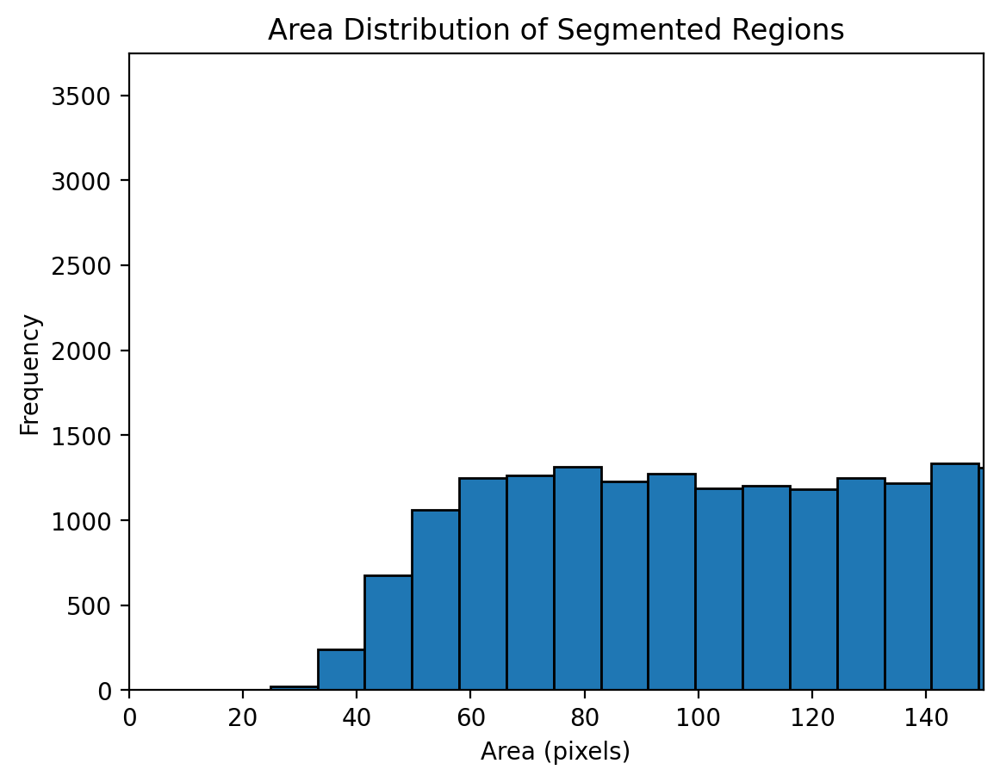

In [10]:
gdf['area'] = gdf['geometry'].area

# Draw area distribution histogram
plt.hist(gdf['area'], bins=700, edgecolor="black")
plt.xlabel("Area (pixels)")
plt.ylabel("Frequency")
plt.title("Area Distribution of Segmented Regions")
plt.xlim(0, 150) # can adjust it
plt.show()

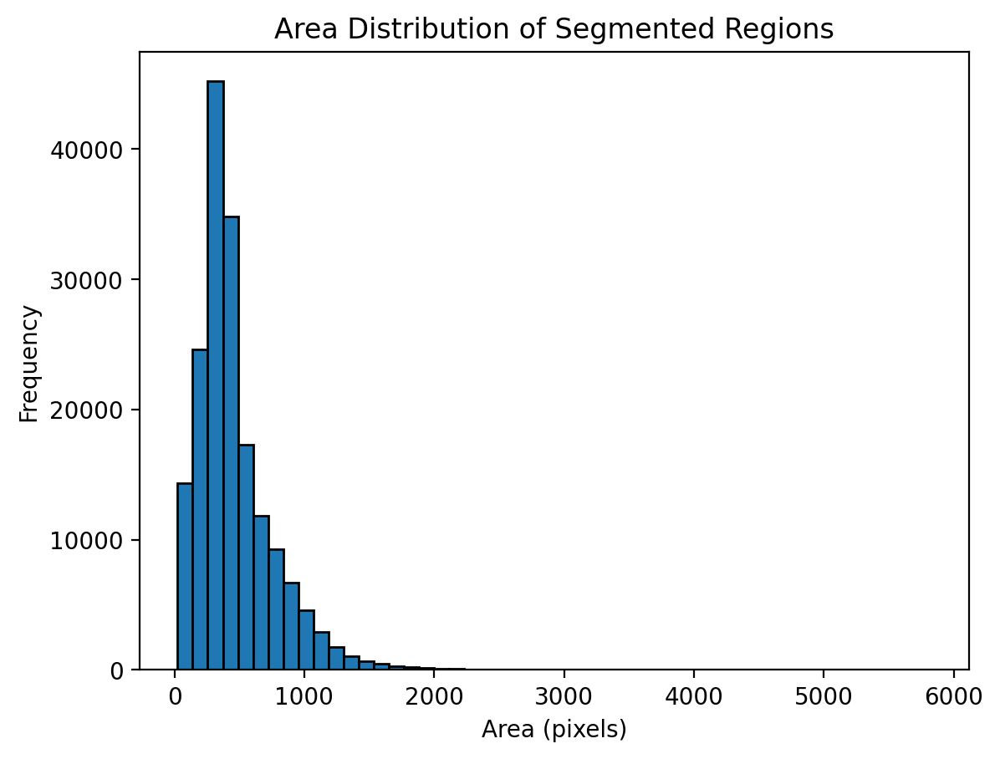

In [11]:
gdf['area'] = gdf['geometry'].area

# Draw area distribution histogram
plt.hist(gdf['area'], bins=50, edgecolor="black")
plt.xlabel("Area (pixels)")
plt.ylabel("Frequency")
plt.title("Area Distribution of Segmented Regions")
plt.show()

In [12]:
# Filter out nuclei with an area greater than 35 and less than 1500
gdf_filtered = gdf[(gdf['area'] > 35) & (gdf['area'] < 1500)]

num_cells_unfiltered = len(gdf)
num_cells_filtered = len(gdf_filtered)
print(f"Total number of segmented cells(unfiltered): {num_cells_unfiltered}")
print(f"Total number of segmented cells(filtered): {num_cells_filtered}")

Total number of segmented cells(unfiltered): 176605
Total number of segmented cells(filtered): 174930


### Visualize the results of cell nucleus segmentation. (Cell density heat map)
Compare with the original HE image to observe whether the cell density is consistent with the original image and whether the noise effect has been eliminated.  
Be sure that the expression data and tissue position files are in the same directory as the high-resolution H&E microscope image.

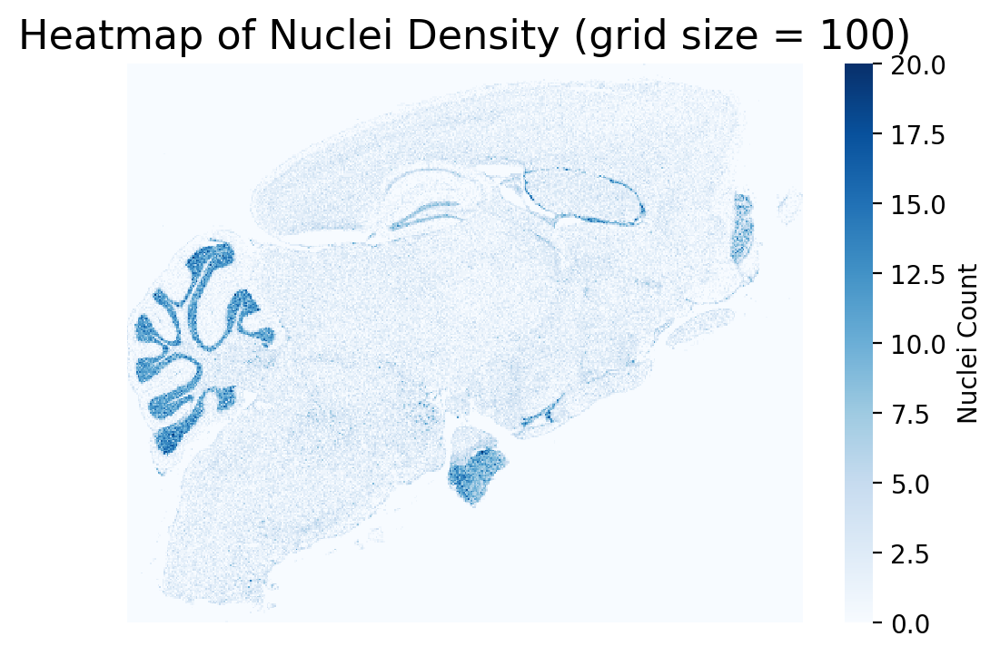

In [13]:
# Define the coordinates of the nucleus (gdf.geometry) and the dimensions of the image
x_coords = [geom.centroid.x for geom in gdf.geometry]
y_coords = [geom.centroid.y for geom in gdf.geometry]

# Defines the size of the grid. 0.27 microns per pixel in this data.
grid_size = 100  # You can adjust the size of the grid as needed.333 is almost the same size as the visium spot. 

# Create a two-dimensional grid to count the number of cell nuclei within each grid
x_bins = np.arange(min(x_coords), max(x_coords), grid_size)
y_bins = np.arange(min(y_coords), max(y_coords), grid_size)

# Count the number of cell nuclei in each grid
heatmap_data = np.zeros((len(y_bins) - 1, len(x_bins) - 1))

for x, y in zip(x_coords, y_coords):
    # Find the grid where the cell nucleus is located
    x_bin = np.digitize(x, x_bins) - 1  # -1 is because np.digitize returns a 1-based index
    y_bin = np.digitize(y, y_bins) - 1
    if 0 <= x_bin < heatmap_data.shape[1] and 0 <= y_bin < heatmap_data.shape[0]:
        heatmap_data[y_bin, x_bin] += 1

# Draw a heat map
plt.figure(figsize=(6, 4))
sns.heatmap(heatmap_data, cmap='Blues', xticklabels=5, yticklabels=5, cbar_kws={'label': 'Nuclei Count'})
plt.title("Heatmap of Nuclei Density (grid size = 100)",fontsize=16)
plt.axis('off')
#plt.rcParams['figure.dpi'] = 300 # resolution
plt.xlabel("X Coordinate")
plt.ylabel("Y Coordinate")
plt.show()

## Load spatial transcription data and perform cell counting ， 
In the following code block, we load the Visium gene expression data and tissue position information.

In [14]:
adata = sc.read_10x_h5('../CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain_filtered_feature_bc_matrix.h5')

#Calculate QC metrics
adata.var_names_make_unique()
adata.var["mt"] = adata.var_names.str.startswith("mt-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

# Load the Spatial Coordinates
tissue_position_file = '../spatial/spatial/tissue_positions.csv'
df_tissue_positions = pd.read_csv(tissue_position_file, index_col='barcode')

# Merge into adata.obs
adata.obs = adata.obs.merge(df_tissue_positions, left_index=True, right_index=True, how='left')

# Ensuring a successful merger
assert adata.obs.shape[0] == adata.n_obs, "Number of rows in adata.obs doesn't match expected."

# Create a GeoDataFrame from the DataFrame of coordinates
geometry = [Point(xy) for xy in zip(df_tissue_positions['pxl_col_in_fullres'], df_tissue_positions['pxl_row_in_fullres'])]
gdf_coordinates = gpd.GeoDataFrame(df_tissue_positions, geometry=geometry)

# Filter tissue_positions to match the index of adata.obs
df_tissue_positions = df_tissue_positions.loc[adata.obs.index]

# Make sure the number of entries matches
assert df_tissue_positions.shape[0] == adata.obs.shape[0], "The number of rows does not match, check whether the index is aligned"

# Store pixel coordinates (full resolution) into a 2D array
spatial_coords = np.array([df_tissue_positions['pxl_col_in_fullres'], 
                           df_tissue_positions['pxl_row_in_fullres']]).T

# Store spatial coordinates in obsm of adata
adata.obsm['spatial'] = spatial_coords

# Read the JSON file ( it contains image scale information, etc.)
scalefactors_file = '../spatial/spatial/scalefactors_json.json'
with open(scalefactors_file, 'r') as f:
    scalefactors = json.load(f)

# Read image file
hires_image_file = '../spatial/spatial/tissue_hires_image.png'
lowres_image_file = '../spatial/spatial/tissue_lowres_image.png'

# Read the image using PIL and convert to NumPy array
img_hires = np.array(Image.open(hires_image_file))
img_lowres = np.array(Image.open(lowres_image_file))

# Add data to adata.uns
adata.uns['spatial'] = {
    'CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain': {
        'images': {
            'hires': img_hires,
            'lowres': img_lowres
        },
        'scalefactors': scalefactors
    }
}


In [15]:
adata

AnnData object with n_obs × n_vars = 6965 × 19465
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'

## Cell counting 

In [16]:
%%time

def count_nuclei(spot_batch, nuclei_geometries, progress_queue):
    """
    Count the number of cell nuclei covered by each spot (subprocess function).
    """
    counts = []
    for spot in spot_batch:
        nuclei_count = sum(spot.intersects(nuclei) for nuclei in nuclei_geometries)
        counts.append(nuclei_count)
    progress_queue.put(len(spot_batch))  # Report the number of completed tasks to the progress queue
    return counts

# Extract scalefactors and spot_diameter_fullres
scalefactors = adata.uns['spatial']['CytAssist_Fresh_Frozen_Sagittal_Mouse_Brain']['scalefactors']
spot_diameter_fullres = scalefactors['spot_diameter_fullres']
spot_radius = spot_diameter_fullres / 2
spot_coords = np.array(adata.obsm["spatial"]) 

# Increase Spot radius to expand coverage
spot_radius *= 1.5  # Increase by 50%
spot_geometries = [Point(coord).buffer(spot_radius) for coord in spot_coords]
spot_gdf = gpd.GeoDataFrame(geometry=spot_geometries, index=adata.obs.index)

# Create the spot geometry to simulate the visium spot (use buffer to generate a circle)
spot_geometries = [Point(coord).buffer(spot_radius) for coord in spot_coords]
spot_gdf = gpd.GeoDataFrame(geometry=spot_geometries, index=adata.obs.index)

# Prepare multi-process tasks
spot_batches = np.array_split(spot_gdf.geometry, mp.cpu_count())  
nuclei_geometries = list(gdf.geometry)  


total_tasks = len(spot_gdf.geometry) 
progress_queue = mp.Manager().Queue()  

def update_progress_bar(progress_queue, total_tasks):
    """Function that updates the progress bar (runs in the main process)."""
    with tqdm(total=total_tasks, desc="Processing spots") as pbar:
        completed = 0
        while completed < total_tasks:
            completed += progress_queue.get()
            pbar.update(completed - pbar.n)

# Start multi-process computing
with mp.Pool(processes=mp.cpu_count()) as pool:
    # Start the progress bar update thread
    progress_thread = mp.Process(target=update_progress_bar, args=(progress_queue, total_tasks))
    progress_thread.start()
    
    # Execute multi-process tasks
    results = pool.starmap(count_nuclei, [(batch, nuclei_geometries, progress_queue) for batch in spot_batches])
    
    
    progress_thread.join()

# Merge results
nuclei_counts = [count for batch in results for count in batch]

# Store the number of nuclei in adata.obs
adata.obs["nuclei_count"] = nuclei_counts

# Check the results
print(adata.obs["nuclei_count"].head())

Processing spots: 100%|█████████████████████| 6965/6965 [39:18<00:00,  2.95it/s]


AACAATGGAACCACAT-1    76
AACAATGTGCTCCGAG-1    27
AACACCAGCCTACTCG-1    18
AACACCGAGCTTGGAT-1     6
AACACGACAACGGAGT-1    15
Name: nuclei_count, dtype: int64
CPU times: user 6min 43s, sys: 16 s, total: 6min 59s
Wall time: 39min 26s


### Visualize cell counts and spot sizes and spacing is suitable .

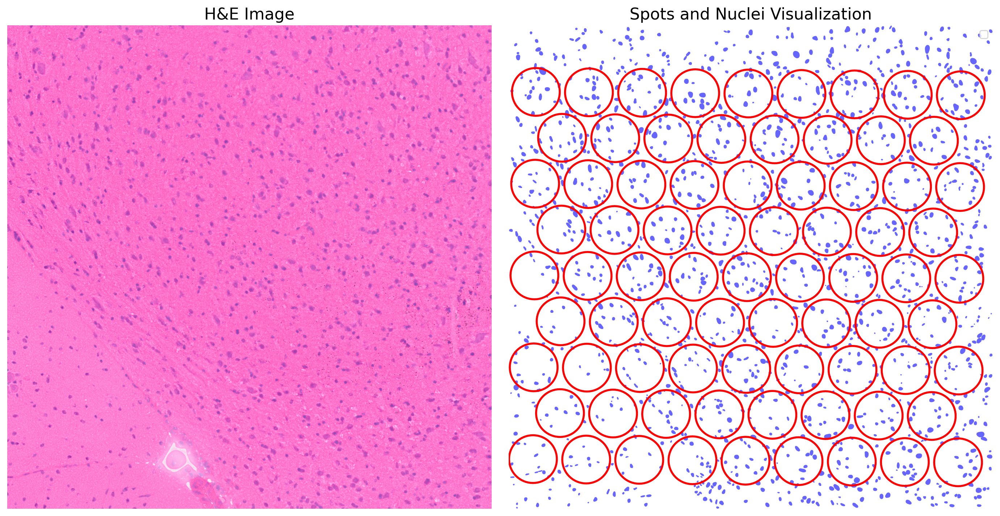

In [17]:
crop_he = img_he[14000:17330, 10000:13330]
crop_pred = labels[14000:17330, 10000:13330]

# Visualize the cropping regions of Spot and Nuclei
cropped_nuclei = gdf[gdf.geometry.apply(lambda geom: geom.bounds[0] >= 10000 and 
                                                     geom.bounds[2] <= 13330 and 
                                                     geom.bounds[1] >= 14000 and 
                                                     geom.bounds[3] <= 17330)]

cropped_spots = spot_gdf[spot_gdf.geometry.apply(lambda geom: geom.bounds[0] >= 10000 and 
                                                             geom.bounds[2] <= 13330 and 
                                                             geom.bounds[1] >= 14000 and 
                                                             geom.bounds[3] <= 17330)]


fig, axes = plt.subplots(1, 2, figsize=(14, 7))

# Display cropped H&E image
axes[0].imshow(crop_he)
axes[0].set_title('H&E Image', fontsize=16)
axes[0].axis('off')
# Display Spots and Nuclei and ensure the range is consistent with the H&E image
cropped_nuclei.plot(ax=axes[1], color='blue', alpha=0.6, label='Nuclei')
cropped_spots.plot(ax=axes[1], edgecolor='red',linewidth=2, facecolor='none', label='Spots')
axes[1].set_title("Spots and Nuclei Visualization", fontsize=16)

# Sets the same range as axes[0]
axes[1].set_xlim(10000, 13330)
axes[1].set_ylim(14000, 17330)  # Note that this is inverted, with the maximum y value at the bottom
axes[1].axis('off')
axes[1].legend()
axes[1].invert_yaxis()

plt.tight_layout()
plt.show()

### Visualization

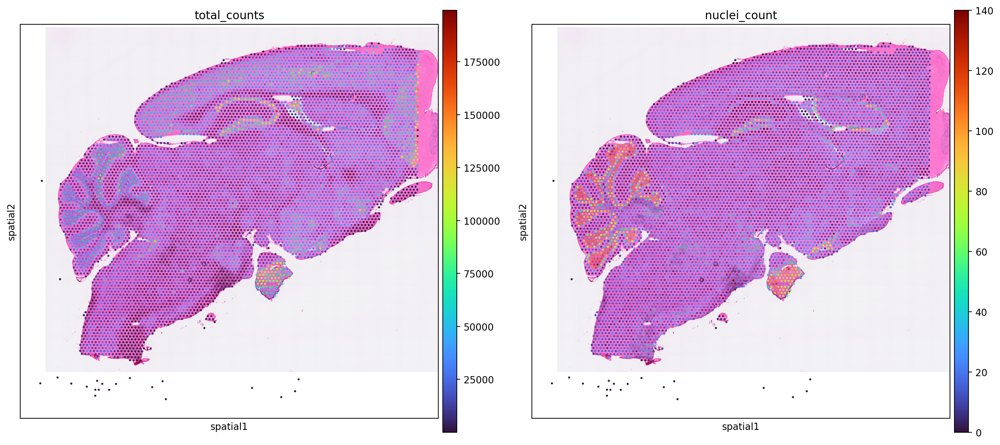

In [18]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(adata, img_key="hires", cmap="turbo",color=["total_counts", "nuclei_count"])

### Save the result

In [ ]:
adata.write('data/deconvolution_input.h5ad')